In this notebook we perform experiments about the capabilities of LLMs of understanding the legality of moves in board games. 

We focus on the board game Chef's Hat (https://whisperproject.eu/chefshat). The rulebook is available at (https://github.com/pablovin/ChefsHatGYM/blob/master/gitImages/RulebookMenuv08.pdf).

In particular, the players have agency only on the first two phases of each round, and most of the decisions take in place during the second phase, which is the focus of this project work.

In this phase, players can either or play a hand of cards; the played cards must be played on top the cards already present on the board, and all of the cards must have the same value, which must be lower than the value of cards on the board. Moreover, it is not possible to play less cards than the amount of cards that are already on the board. Jokers can replace any card when played on the board, and any card can be put on top of them.

# Importing and cleaning data

We begin by creating our dataframe:

In [1]:
import pickle
import pandas as pd
import numpy as np
import torch
import transformers
import torch
import networkx as nx
from transformers import AutoModelForCausalLM, AutoTokenizer, BitsAndBytesConfig  
import random

random_state = 1

random.seed()

In [2]:
with open('Dataset.pkl', 'rb') as f:
    data = pickle.load(f)

C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\3991492128.py:2: DeprecationWarning: numpy.core.numeric is deprecated and has been renamed to numpy._core.numeric. The numpy._core namespace contains private NumPy internals and its use is discouraged, as NumPy internals can change without warning in any release. In practice, most real-world usage of numpy.core is to access functionality in the public NumPy API. If that is the case, use the public NumPy API. If not, you are using NumPy internals. If you would still like to access an internal attribute, use numpy._core.numeric._frombuffer.
  data = pickle.load(f)


We use the Hamming distance in order to measures (dis)similarity between instances.

In [3]:
def hamming(s1, s2):
    if len(s1) != len(s2):
        raise ValueError("Undefined for sequences of unequal length")
    return sum(ch1 != ch2 for ch1, ch2 in zip(s1, s2))   

In [4]:
def IoU_lists(s1: list[str], s2: list[str]) -> float:
    set1, set2 = set(s1), set(s2)
    return len(set1 & set2) / len(set1 | set2)

We inspect the attributes of the dataset; we will focus only on the "DISCARD" actions.

In [5]:
print(data.columns)
data

Index(['Match', 'Round', 'Agent_Names', 'Source', 'Action_Type',
       'Action_Description', 'Player_Finished', 'Player_Hands', 'Board_Before',
       'Board_After', 'Possible_Actions', 'Current_Roles', 'Match_Score',
       'Game_Score', 'Game_Performance_Score'],
      dtype='object')


,Match,Round,Agent_Names,Source,Action_Type,Action_Description,Player_Finished,Player_Hands,Board_Before,Board_After,Possible_Actions,Current_Roles,Match_Score,Game_Score,Game_Performance_Score
2024-11-21_15:03:51.314611,0,0,"[RANDOM_01, RANDOM_02, RANDOM_03, RANDOM_04]",SYSTEM,START_EXPERIMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-11-21_15:03:51.314611,1,0,NaN,SYSTEM,NEW_MATCH,NaN,NaN,NaN,NaN,NaN,NaN,"{'RANDOM_01': '', 'RANDOM_02': '', 'RANDOM_03'...",NaN,"{'RANDOM_01': -1, 'RANDOM_02': -1, 'RANDOM_03'...",NaN
2024-11-21_15:03:51.315609,1,0,NaN,SYSTEM,DEAL_CARDS,NaN,NaN,"[[3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, 9, 0, 0, 0,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-11-21_15:03:51.327717,1,1,NaN,RANDOM_01,DISCARD,C11;Q4;J0,0.0,"[0, 0, 0, 0, 3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]","[C11;Q1;J0, C11;Q1;J1, C11;Q2;J0, C11;Q2;J1, C...",NaN,NaN,NaN,NaN
2024-11-21_15:03:51.336602,1,1,NaN,RANDOM_02,DISCARD,pass,False,"[1, 4, 5, 5, 5, 6, 6, 7, 7, 7, 8, 9, 10, 10, 1...","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]",[pass],NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-11-21_15:06:08.055500,100,26,NaN,RANDOM_01,DISCARD,pass,False,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C11;Q1;J0, pass]",NaN,NaN,NaN,NaN
2024-11-21_15:06:08.067496,100,26,NaN,RANDOM_02,DISCARD,C8;Q1;J0,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C8;Q1;J0, pass]",NaN,NaN,NaN,NaN
2024-11-21_15:06:08.070494,100,26,NaN,RANDOM_02,DECLARE_PIZZA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-11-21_15:06:08.341109,100,26,NaN,SYSTEM,END_MATCH,NaN,NaN,NaN,NaN,NaN,NaN,"{'RANDOM_01': 'Dishwasher', 'RANDOM_02': 'Wait...","{'RANDOM_01': 0, 'RANDOM_02': 1, 'RANDOM_03': ...","{'RANDOM_01': 141, 'RANDOM_02': 150, 'RANDOM_0...",NaN


In [6]:
players = data['Agent_Names'][0]
players

C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\3392628886.py:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  players = data['Agent_Names'][0]


['RANDOM_01', 'RANDOM_02', 'RANDOM_03', 'RANDOM_04']

In [7]:
data.columns

Index(['Match', 'Round', 'Agent_Names', 'Source', 'Action_Type',
       'Action_Description', 'Player_Finished', 'Player_Hands', 'Board_Before',
       'Board_After', 'Possible_Actions', 'Current_Roles', 'Match_Score',
       'Game_Score', 'Game_Performance_Score'],
      dtype='object')

In [8]:
data_refactored = data[(data['Match'] > 0) & (data['Round'] > 0) & (data['Action_Type'] == 'DISCARD')][['Match', 'Action_Description', 'Player_Hands', 'Board_Before', 'Possible_Actions']]

data_refactored



,Match,Action_Description,Player_Hands,Board_Before,Possible_Actions
2024-11-21_15:03:51.327717,1,C11;Q4;J0,"[0, 0, 0, 0, 3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C11;Q1;J0, C11;Q1;J1, C11;Q2;J0, C11;Q2;J1, C..."
2024-11-21_15:03:51.336602,1,pass,"[1, 4, 5, 5, 5, 6, 6, 7, 7, 7, 8, 9, 10, 10, 1...","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]",[pass]
2024-11-21_15:03:51.346670,1,pass,"[2, 4, 5, 6, 6, 7, 8, 8, 8, 8, 9, 9, 10, 10, 1...","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]","[C8;Q4;J0, pass]"
2024-11-21_15:03:51.356687,1,C10;Q4;J0,"[0, 0, 0, 0, 2, 3, 4, 4, 6, 6, 7, 9, 9, 10, 10...","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]","[C10;Q3;J1, C10;Q4;J0, C10;Q4;J1, C10;Q5;J0, C..."
2024-11-21_15:03:51.365671,1,C9;Q4;J0,"[0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 5, 7, 7, 8, 8, ...","[10, 10, 10, 10, 0, 0, 0, 0, 0, 0, 0]","[C8;Q3;J1, C9;Q3;J1, C9;Q4;J0, C9;Q4;J1, pass]"
...,...,...,...,...,...
2024-11-21_15:06:08.018273,100,pass,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",[pass]
2024-11-21_15:06:08.028495,100,pass,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C8;Q1;J0, pass]"
2024-11-21_15:06:08.036495,100,C10;Q1;J0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C10;Q1;J0, C11;Q1;J0, pass]"
2024-11-21_15:06:08.055500,100,pass,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C11;Q1;J0, pass]"


In data_refactored, Player_Hands lists the cards that remain in hand AFTER the player has taken the action described in Action_Description.
 
We want to restore the correct player hand so that the Possible_actions column refers to the current player hand and board.

In [9]:
Action_Description_Refactored = data[(data['Match'] > 0) & (data['Round'] > 0) & (data['Action_Type'] == 'DISCARD')]['Action_Description']

New_Action_Description = []

for i in Action_Description_Refactored:
    if i != 'pass':
        actionlist = i.split(';')
    else:
        actionlist = i
    New_Action_Description.append(actionlist)

data_refactored['Action_Description'] = New_Action_Description


In [10]:
Player_Hand_Refactored = []

for i in range(len(data_refactored)):
        newel = list(data_refactored['Player_Hands'][i])
        if data_refactored['Action_Description'][i] != 'pass':
                number = int(data_refactored['Action_Description'][i][0][1:])
                quantity = int(data_refactored['Action_Description'][i][1][1:])
                jolly = int(data_refactored['Action_Description'][i][2][1:])
                for k in range(quantity):
                        newel[newel.index(0)] = number
                for j in range(jolly):
                        newel[newel.index(0)] = 12
        newel.sort(reverse = False)
        newel = [int(i) for i in newel]
        Player_Hand_Refactored.append(newel)

data_refactored['Player_Hands'] = Player_Hand_Refactored
data_refactored

C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\666179860.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  newel = list(data_refactored['Player_Hands'][i])
C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\666179860.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if data_refactored['Action_Description'][i] != 'pass':
C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\666179860.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]

,Match,Action_Description,Player_Hands,Board_Before,Possible_Actions
2024-11-21_15:03:51.327717,1,"[C11, Q4, J0]","[3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, 9, 11, 11, 1...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C11;Q1;J0, C11;Q1;J1, C11;Q2;J0, C11;Q2;J1, C..."
2024-11-21_15:03:51.336602,1,pass,"[1, 4, 5, 5, 5, 6, 6, 7, 7, 7, 8, 9, 10, 10, 1...","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]",[pass]
2024-11-21_15:03:51.346670,1,pass,"[2, 4, 5, 6, 6, 7, 8, 8, 8, 8, 9, 9, 10, 10, 1...","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]","[C8;Q4;J0, pass]"
2024-11-21_15:03:51.356687,1,"[C10, Q4, J0]","[2, 3, 4, 4, 6, 6, 7, 9, 9, 10, 10, 10, 10, 10...","[11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0]","[C10;Q3;J1, C10;Q4;J0, C10;Q4;J1, C10;Q5;J0, C..."
2024-11-21_15:03:51.365671,1,"[C9, Q4, J0]","[0, 0, 0, 0, 3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, ...","[10, 10, 10, 10, 0, 0, 0, 0, 0, 0, 0]","[C8;Q3;J1, C9;Q3;J1, C9;Q4;J0, C9;Q4;J1, pass]"
...,...,...,...,...,...
2024-11-21_15:06:08.018273,100,pass,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",[pass]
2024-11-21_15:06:08.028495,100,pass,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C8;Q1;J0, pass]"
2024-11-21_15:06:08.036495,100,"[C10, Q1, J0]","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C10;Q1;J0, C11;Q1;J0, pass]"
2024-11-21_15:06:08.055500,100,pass,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[C11;Q1;J0, pass]"


We now select only the unique pairs of (player_hand, board_state):

In [11]:
data_refactored['Player_Hands'] = data_refactored['Player_Hands'].apply(tuple)
data_refactored['Board_Before'] = data_refactored['Board_Before'].apply(tuple)

data_refactored_unique = data_refactored.drop_duplicates(subset = ['Player_Hands', 'Board_Before'])
data_refactored_unique

,Match,Action_Description,Player_Hands,Board_Before,Possible_Actions
2024-11-21_15:03:51.327717,1,"[C11, Q4, J0]","(3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, 9, 11, 11, 1...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C11;Q1;J0, C11;Q1;J1, C11;Q2;J0, C11;Q2;J1, C..."
2024-11-21_15:03:51.336602,1,pass,"(1, 4, 5, 5, 5, 6, 6, 7, 7, 7, 8, 9, 10, 10, 1...","(11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0)",[pass]
2024-11-21_15:03:51.346670,1,pass,"(2, 4, 5, 6, 6, 7, 8, 8, 8, 8, 9, 9, 10, 10, 1...","(11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0)","[C8;Q4;J0, pass]"
2024-11-21_15:03:51.356687,1,"[C10, Q4, J0]","(2, 3, 4, 4, 6, 6, 7, 9, 9, 10, 10, 10, 10, 10...","(11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0)","[C10;Q3;J1, C10;Q4;J0, C10;Q4;J1, C10;Q5;J0, C..."
2024-11-21_15:03:51.365671,1,"[C9, Q4, J0]","(0, 0, 0, 0, 3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, ...","(10, 10, 10, 10, 0, 0, 0, 0, 0, 0, 0)","[C8;Q3;J1, C9;Q3;J1, C9;Q4;J0, C9;Q4;J1, pass]"
...,...,...,...,...,...
2024-11-21_15:06:07.788984,100,pass,"(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","(10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C7;Q1;J0, C7;Q2;J0, pass]"
2024-11-21_15:06:07.856173,100,pass,"(0, 0, 0, 0, 0, 0, 0, 8, 9, 10, 10, 10, 10, 11...","(7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)",[pass]
2024-11-21_15:06:07.891175,100,"[C11, Q1, J0]","(0, 0, 0, 0, 0, 0, 0, 8, 9, 10, 10, 10, 10, 11...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C8;Q1;J0, C9;Q1;J0, C10;Q1;J0, C10;Q2;J0, C10..."
2024-11-21_15:06:07.904180,100,"[C11, Q2, J0]","(0, 0, 0, 0, 0, 0, 0, 0, 8, 9, 10, 10, 10, 10,...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C8;Q1;J0, C9;Q1;J0, C10;Q1;J0, C10;Q2;J0, C10..."


In [12]:
data_refactored_unique.iloc[0]['Player_Hands']

(3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, 9, 11, 11, 11, 11, 12)

In [13]:
def unique_cards(listofcards):
    toreturn = []
    for number in range(1,14):
        if number in listofcards and number not in toreturn:
            toreturn.append(number)
    return toreturn

In [14]:
def verbalize_move(movestring):
    cardtype = ''
    card_quantity = ''
    cardtype += movestring[1]
    if movestring[3] == ';':
        cardtype += movestring[2]
        card_quantity += movestring[5]
    else:
        card_quantity += movestring[4]
    if movestring[-1] == '0':
        return ('play '+ card_quantity + ' card(s) with value '+ cardtype)
    else:
        return ('play '+ card_quantity + ' card(s) with value '+ cardtype +' and '+ movestring[-1] + ' Joker cards')

In [15]:
Player_Hands_Verbose = []
Board_Before_Verbose = []
Possible_Actions_Verbose = []

for el in range(len(data_refactored_unique)):
    Player_Hands_temp = []
    Board_Before_temp = []
    Possible_Actions_temp = []

    Player_Hands = data_refactored_unique.iloc[el]['Player_Hands']
    Board_Before = data_refactored_unique.iloc[el]['Board_Before']
    Possible_Actions = data_refactored_unique.iloc[el]['Possible_Actions']

    for value in unique_cards(Player_Hands):
        if value != 12:
            Player_Hands_temp.append(str(data_refactored_unique.iloc[el]['Player_Hands'].count(value))+ ' card(s) with value '+str(value))
    if 12 in data_refactored_unique.iloc[el]['Player_Hands']:
        Player_Hands_temp.append(str(data_refactored_unique.iloc[el]['Player_Hands'].count(12))+ ' Joker cards')
    
    Player_Hands_Verbose.append(Player_Hands_temp)


    for value in unique_cards(Board_Before):
        if value != 12:
            Board_Before_temp.append(str(data_refactored_unique.iloc[el]['Board_Before'].count(value))+ ' card(s) with value '+str(value))
        if 12 in data_refactored_unique.iloc[el]['Board_Before']:
            Board_Before_temp.append(str(data_refactored_unique.iloc[el]['Board_Before'].count(12))+ ' Joker card(s)')
    
    Board_Before_Verbose.append(Board_Before_temp)


    for move in Possible_Actions[:-1]:
        Possible_Actions_temp.append(verbalize_move(move))
    Possible_Actions_temp.append('pass')
    
    Possible_Actions_Verbose.append(Possible_Actions_temp)



    


In [16]:
data_refactored_unique['Player_Hands_Verbose'] = Player_Hands_Verbose
data_refactored_unique['Board_Before_Verbose'] = Board_Before_Verbose
data_refactored_unique['Possible_Actions_Verbose'] = Possible_Actions_Verbose

C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\2452989816.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_refactored_unique['Player_Hands_Verbose'] = Player_Hands_Verbose
C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\2452989816.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_refactored_unique['Board_Before_Verbose'] = Board_Before_Verbose
C:\Users\alfio\AppData\Local\Temp\ipykernel_21148\2452989816.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

In [17]:
data_refactored_unique

,Match,Action_Description,Player_Hands,Board_Before,Possible_Actions,Player_Hands_Verbose,Board_Before_Verbose,Possible_Actions_Verbose
2024-11-21_15:03:51.327717,1,"[C11, Q4, J0]","(3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, 9, 11, 11, 1...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C11;Q1;J0, C11;Q1;J1, C11;Q2;J0, C11;Q2;J1, C...","[2 card(s) with value 3, 1 card(s) with value ...",[1 card(s) with value 13],"[play 1 card(s) with value 11, play 1 card(s) ..."
2024-11-21_15:03:51.336602,1,pass,"(1, 4, 5, 5, 5, 6, 6, 7, 7, 7, 8, 9, 10, 10, 1...","(11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0)",[pass],"[1 card(s) with value 1, 1 card(s) with value ...",[4 card(s) with value 11],[pass]
2024-11-21_15:03:51.346670,1,pass,"(2, 4, 5, 6, 6, 7, 8, 8, 8, 8, 9, 9, 10, 10, 1...","(11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0)","[C8;Q4;J0, pass]","[1 card(s) with value 2, 1 card(s) with value ...",[4 card(s) with value 11],"[play 4 card(s) with value 8, pass]"
2024-11-21_15:03:51.356687,1,"[C10, Q4, J0]","(2, 3, 4, 4, 6, 6, 7, 9, 9, 10, 10, 10, 10, 10...","(11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0)","[C10;Q3;J1, C10;Q4;J0, C10;Q4;J1, C10;Q5;J0, C...","[1 card(s) with value 2, 1 card(s) with value ...",[4 card(s) with value 11],[play 3 card(s) with value 10 and 1 Joker card...
2024-11-21_15:03:51.365671,1,"[C9, Q4, J0]","(0, 0, 0, 0, 3, 3, 5, 7, 7, 8, 8, 8, 9, 9, 9, ...","(10, 10, 10, 10, 0, 0, 0, 0, 0, 0, 0)","[C8;Q3;J1, C9;Q3;J1, C9;Q4;J0, C9;Q4;J1, pass]","[2 card(s) with value 3, 1 card(s) with value ...",[4 card(s) with value 10],[play 3 card(s) with value 8 and 1 Joker cards...
...,...,...,...,...,...,...,...,...
2024-11-21_15:06:07.788984,100,pass,"(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","(10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C7;Q1;J0, C7;Q2;J0, pass]",[2 card(s) with value 7],[1 card(s) with value 10],"[play 1 card(s) with value 7, play 2 card(s) w..."
2024-11-21_15:06:07.856173,100,pass,"(0, 0, 0, 0, 0, 0, 0, 8, 9, 10, 10, 10, 10, 11...","(7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)",[pass],"[1 card(s) with value 8, 1 card(s) with value ...",[1 card(s) with value 7],[pass]
2024-11-21_15:06:07.891175,100,"[C11, Q1, J0]","(0, 0, 0, 0, 0, 0, 0, 8, 9, 10, 10, 10, 10, 11...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C8;Q1;J0, C9;Q1;J0, C10;Q1;J0, C10;Q2;J0, C10...","[1 card(s) with value 8, 1 card(s) with value ...",[1 card(s) with value 13],"[play 1 card(s) with value 8, play 1 card(s) w..."
2024-11-21_15:06:07.904180,100,"[C11, Q2, J0]","(0, 0, 0, 0, 0, 0, 0, 0, 8, 9, 10, 10, 10, 10,...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C8;Q1;J0, C9;Q1;J0, C10;Q1;J0, C10;Q2;J0, C10...","[1 card(s) with value 8, 1 card(s) with value ...",[1 card(s) with value 13],"[play 1 card(s) with value 8, play 1 card(s) w..."


In [ ]:
df_train = data_refactored_unique[(data_refactored_unique['Match'] <= 97)]
df_train_shuffled = df_train#.sample(frac=1, random_state = random_state).reset_index(drop=True) #The other random_states in the .sample() methods shall be left fixed in order to guarantee that the test set remains the same
df_train_shuffled

,Match,Action_Description,Player_Hands,Board_Before,Possible_Actions,Player_Hands_Verbose,Board_Before_Verbose,Possible_Actions_Verbose
0,38,"[C3, Q1, J0]","(0, 0, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 10...","(11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C1;Q1;J0, C2;Q1;J0, C3;Q1;J0, C4;Q1;J0, C5;Q1...","[1 card(s) with value 1, 1 card(s) with value ...",[1 card(s) with value 11],"[play 1 card(s) with value 1, play 1 card(s) w..."
1,11,"[C8, Q3, J0]","(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 8, 8, ...","(9, 9, 9, 0, 0, 0, 0, 0, 0, 0, 0)","[C8;Q3;J0, C8;Q4;J0, pass]","[1 card(s) with value 7, 4 card(s) with value 8]",[3 card(s) with value 9],"[play 3 card(s) with value 8, play 4 card(s) w..."
2,80,pass,"(0, 0, 0, 0, 0, 0, 0, 0, 5, 8, 10, 10, 10, 11,...","(9, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0)",[pass],"[1 card(s) with value 5, 1 card(s) with value ...",[2 card(s) with value 9],[pass]
3,5,"[C11, Q2, J0]","(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 9, 11, 11...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C5;Q1;J0, C9;Q1;J0, C11;Q1;J0, C11;Q2;J0, C11...","[1 card(s) with value 5, 1 card(s) with value ...",[1 card(s) with value 13],"[play 1 card(s) with value 5, play 1 card(s) w..."
4,10,"[C4, Q1, J0]","(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 6, 8, 10,...","(5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C4;Q1;J0, pass]","[1 card(s) with value 4, 1 card(s) with value ...",[1 card(s) with value 5],"[play 1 card(s) with value 4, pass]"
...,...,...,...,...,...,...,...,...
7593,11,pass,"(0, 0, 4, 6, 6, 7, 7, 8, 8, 9, 9, 9, 10, 10, 1...","(12, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0)",[pass],"[1 card(s) with value 4, 2 card(s) with value ...","[1 card(s) with value 3, 1 Joker card(s), 1 Jo...",[pass]
7594,65,pass,"(0, 2, 6, 6, 6, 6, 8, 8, 9, 10, 10, 10, 10, 10...","(3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C2;Q1;J0, pass]","[1 card(s) with value 2, 4 card(s) with value ...",[1 card(s) with value 3],"[play 1 card(s) with value 2, pass]"
7595,49,"[C1, Q1, J0]","(0, 0, 0, 0, 0, 0, 0, 0, 1, 3, 5, 6, 9, 10, 11...","(13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)","[C1;Q1;J0, C3;Q1;J0, C5;Q1;J0, C6;Q1;J0, C9;Q1...","[1 card(s) with value 1, 1 card(s) with value ...",[1 card(s) with value 13],"[play 1 card(s) with value 1, play 1 card(s) w..."
7596,3,pass,"(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 10,...","(10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)",[pass],"[2 card(s) with value 10, 1 card(s) with value...",[1 card(s) with value 10],[pass]


In [19]:
df_test = data_refactored_unique[(data_refactored_unique['Match'] > 97)]

# Experiments

We perform experiments with the Llama-3.1-8B-Instruct model from Huggingface. We adopt 4-bit quantization for improving speed and performances. In all of the experiments we include three settings.

In the first case we do not provide any explanation about the semantics of the input and just ask the model to complete the query based on the provided examples.

In the second case we provide a basic explanation of the input, without references to the rules of the game.

Last, we give a full explanation about the semantics of the input, the rules of the game, and include known techniques of prompt engineering.

We evaluate results according to several metrics: all_moves_accuracy (the fraction of instances for which the full correct list of legal moves is returned), TP (the number of correctly identified legal moves), FP (the number of illegal moves returned), FN (the legal moves which are not returned by the model) and IoU_lists (a variant of Intersection over Union for lists)

In [20]:
model_id = "meta-llama/Meta-Llama-3.1-8B-Instruct"

pipeline = transformers.pipeline(
    "text-generation",
    model=model_id,
    model_kwargs={"torch_dtype": torch.bfloat16,
                  "quantization_config": {"load_in_4bit": True}},
    device_map="cuda:0"
)

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

Device set to use cuda:0


## Experiment 3: Graph-Based Example Selection

In this last experiment we test the effectiveness of Graph-based example retrieval in the in-context learning setting.

At first, we construct the "training set graph": in this graph nodes are examples from the training set, and edges are constructed between nodes when a similarity score between the examples is greater than a threshold T (or the dissimilarity or distance is below a threshold T).

At test time, for each test instance we extract a subgraph of the constructed larger graph by only selecting nodes that represent examples that are close to the test instance, and returning examples according to a suitable function of the graph (in this case we return the top 5/10/15 nodes according to the PageRank metric (see the notebook for details)).

Note that at inference time there is no need to rebuild the full training set graph; instead it is equivalent and might be more convenient to directly construct the subgraph by only considering the closest nodes to the prompt instance.

Another thing to consider is that for this method to differ from the previous KNN approach, the number of nodes belonging to the extracted subgraph should be (somewhat considerably) greater than 5/10/15 (in general, K) respectively.

In [21]:
# "Training set graph" construction:

Training_graph = pickle.load(open('game_.01.pickle', 'rb'))

In [22]:
len(Training_graph.edges())

775159

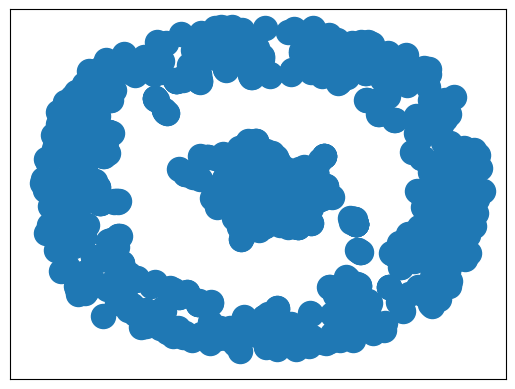

In [23]:
nx.draw_networkx(Training_graph, with_labels = False)

### No explanations provided

In [24]:
template = '''You are an expert board game player, and you are playing a card game called Chef’s Hat. This game is played with cards with values ranging from 1 to 13, both included.

In the following examples "A" provides two lists. 
The first list is a description of the cards in hand of a player.
The second list is a description of the cards that are already on the board

Then "B" replies with the full list of the current legal moves in the situation presented by "A".

As a player, you have to play cards on the board. The cards played must all have the same value, and this value must be strictly lower than the value of the cards currently on the board.
You cannot place less cards on the board than the amount of cards currently present there. 
If you have Joker cards, you can use them as if they had any value.
Make sure to add the 'pass' move to the returned list of moves.

Complete the text by listing all the current legal moves given the last description from "A". Only add the text that comes after "B: ".'''

In [25]:
def test(template, nexamples, radius):

    count = 0
    IoU = 0
    TP = 0
    FN = 0
    FP = 0

    for i in range(len(df_test)):

        subgraph_radius = radius

        query = 'A: Player hand: '+ str(df_test.iloc[i]['Player_Hands_Verbose'])+', Board state: '+str(df_test.iloc[i]['Board_Before_Verbose'])+'\n'+'B: '

        test_graph = Training_graph.copy()   

        for j in range(len(df_train_shuffled)):    #Drop nodes that are too far (in this case, hamming > 6) from the test instance
            if hamming(df_train_shuffled.iloc[j]['Player_Hands'] + df_train_shuffled.iloc[j]['Board_Before'], df_test.iloc[i]['Player_Hands'] + df_test.iloc[i]['Board_Before']) > subgraph_radius:
                test_graph.remove_node(j)

    
        while(len(test_graph) < nexamples):     #If the subgraph doesn't have enough nodes, increment the radius
            subgraph_radius += 1
            test_graph = Training_graph.copy()
            for j in range(len(df_train)):
                if hamming(df_train_shuffled.iloc[j]['Player_Hands'] + df_train_shuffled.iloc[j]['Board_Before'], df_test.iloc[i]['Player_Hands'] + df_test.iloc[i]['Board_Before']) > subgraph_radius:
                    test_graph.remove_node(j)

        selected_nodes = []

        communities = nx.community.louvain_communities(test_graph, seed = random_state)
        sorted_communities = sorted(communities, key = lambda x: len(x), reverse = True)

        if len(sorted_communities) >= nexamples:    #If there are enough communities:
            for l in range(nexamples):
                subgraph = test_graph.subgraph(sorted_communities[l])
                selected_nodes.append(sorted(nx.pagerank(subgraph).items(), key=lambda kv: kv[1], reverse = True )[0][0])

        else:                                       #If there are less communities than nodes to choose:
            numberofelements = 2
            while len(selected_nodes) < nexamples:
                selected_nodes = []
                for element in sorted_communities:
                    subgraph = test_graph.subgraph(element)
                    selected_nodes += [foo[0] for foo in sorted(nx.pagerank(subgraph).items(), key=lambda kv: kv[1], reverse = True )][:numberofelements]
                    numberofelements += 1

        selected_nodes = selected_nodes[:nexamples]

        text_examples = ''

        for el in selected_nodes:
            text_examples += 'A: Player hand: '+ str(df_train.iloc[el]['Player_Hands_Verbose']) + ';\nBoard state: ' + str(df_train.iloc[el]['Board_Before_Verbose']) + '\n'+'B: ' + str(df_train.iloc[el]['Possible_Actions_Verbose'])+'\n\n'

        print('query:\n'+ query,'\n')
        print('retrieved examples:\n\n'+ text_examples,'\n\n')

        messages = [{'role': 'system', 'content': template},{"role": "user", "content": text_examples},{"role": "user", "content": query}]

        outputs = pipeline(
            messages,
            max_new_tokens=500,
            do_sample = False
        )
        #print(outputs[0]['generated_text'][-1]['content'])
        if outputs[0]['generated_text'][-1]['content'][0] == 'B':
            ref_output = outputs[0]['generated_text'][-1]['content'][4:-1].split(sep = ', ')
        else:
            ref_output = outputs[0]['generated_text'][-1]['content'][1:-1].split(sep = ', ')
        final_output = [elem[1:-1] for elem in ref_output]
        print('LLM output:', final_output)
        print('ground truth:', df_test.iloc[i]['Possible_Actions_Verbose'])
        print(200*'-')

        if final_output == df_test.iloc[i]['Possible_Actions']: #should change to _Verbose
            count += 1

        TP_temp = len(set(final_output) & set(df_test.iloc[i]['Possible_Actions_Verbose']))
        TP += TP_temp
        print('TP:', TP_temp)

        FN_temp = len(set(df_test.iloc[i]['Possible_Actions_Verbose']) - set(final_output))
        FN += FN_temp
        print('FN:', FN_temp)

        FP_temp = len(set(final_output) - set(df_test.iloc[i]['Possible_Actions_Verbose']))
        FP += FP_temp
        print('FP:', FP_temp)

        IoU_serv = IoU_lists(final_output, df_test.iloc[i]['Possible_Actions_Verbose'])
        IoU += IoU_serv
        print('IoU:', IoU_serv,'\n\n')
    
    print('all_moves_accuracy:', count/len(df_test))
    print('Avg. IoU:', IoU/len(df_test))
    print('TP total:', TP)
    print('FP total:', FP)
    print('FN total:', FN)

        


In [26]:
#outputetc = '''B: ['play 3 card(s) with value 10', 'play 2 card(s) with value 9', 'play 2 card(s) with value 8', 'play 2 card(s) with value 7', 'play 2 card(s) with value 6']'''
#asd = outputetc[4:-1].split(sep = ', ')
#[elem[1:-1] for elem in asd]


In [27]:
#A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
#Board state: ['1 card(s) with value 9']
#B: ['play 1 card(s) with value 6', 'pass']

 


#LLM output: [" ['play 1 card(s) with value 6", 'play 3 card(s) with value 7', 'play 4 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 10', 'play 6 card(s) with value 11', 'pass']
#ground truth: ['pass']

# R4 r6

#### 5 examples

In [28]:
test(template, 5, 6)

C:\Users\alfio\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\transformers\generation\configuration_utils.py:628: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.6` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
C:\Users\alfio\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\transformers\generation\configuration_utils.py:633: UserWarning: `do_sample` is set to `False`. However, `top_p` is set to `0.9` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `top_p`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with val

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11', '2 Joker card(s)', '2 Joker card(s)']
B: ['play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 Joker cards'];
Board state: ['2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joke

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '4 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 6']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 5', 'pass']

 


LLM ou

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['play 2 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '6 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '4 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board stat

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 10', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

#### 10 examples

In [29]:
test(template, 10, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joke

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 5', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board stat

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 10', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

#### 15 examples

In [30]:
test(template, 15, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joke

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 8', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 5', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board stat

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 10', '4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 10', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

#### 30 examples

In [31]:
test(template, 30, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '5 card(s) with value 10'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 5', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board stat

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 10', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

#### 50 examples

In [32]:
test(template, 50, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '5 card(s) with value 10', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '3 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 5', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board stat

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 10', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

# R4 r5

In [33]:
test(template, 5, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '6 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11', '2 Joker card(s)', '2 Joker card(s)']
B: ['play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 Joker cards'];
Board state: ['2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '4 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 6']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 2', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 2 card(s) with value 3', 'play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['play 2 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '6 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 11']
B: ['play 2 card(s) with value 4 and 1 Joker cards', 'play 2 card(s) with value 6 and 1 Joker cards', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '4 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '3 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 5', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '2 card(s) with value 3', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 8', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

In [34]:
test(template, 10, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 2', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 11']
B: ['play 2 card(s) with value 4 and 1 Joker cards', 'play 2 card(s) with value 6 and 1 Joker cards', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '3 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 8', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

In [35]:
test(template, 15, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 8', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 2', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 10', '4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 8', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

In [36]:
test(template, 30, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '5 card(s) with value 10'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10'];
Board state: ['3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Playe

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 8', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

In [26]:
test(template, 50, 5)

C:\Users\alfio\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\transformers\generation\configuration_utils.py:628: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.6` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
C:\Users\alfio\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\transformers\generation\configuration_utils.py:633: UserWarning: `do_sample` is set to `False`. However, `top_p` is set to `0.9` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `top_p`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '5 card(s) with value 10', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 9', '3 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 8', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Boa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

# R3 r6

In [27]:
Training_graph = pickle.load(open('game_.005.pickle', 'rb'))

In [28]:
test(template, 5, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 2', '2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 8']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 9', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

 


LLM output: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11', '2 Joker card(s)', '2 Joker card(s)']
B: ['play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 Joker cards'];
Board state: ['2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '4 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 6']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '2 card(s) with value 3', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['play 2 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '6 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['play 2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 4 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 

In [29]:
test(template, 10, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 2', '2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 8']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 9', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '4 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 6']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '2 card(s) with value 3', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['play 2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 4 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 

In [30]:
test(template, 15, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 9', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '2 card(s) with value 3', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']



Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['play 2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 4 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 

In [31]:
test(template, 30, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 9', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '2 card(s) with value 3', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 3 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 4', '1 card(s) with value 5', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']



Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7', '1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 

In [32]:
test(template, 50, 6)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 9', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '6 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Playe

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'pass']

A: Player hand:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 

# R3 r5

In [33]:
test(template, 5, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 2', '2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 8']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11', '2 Joker card(s)', '2 Joker card(s)']
B: ['play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 Joker cards'];
Board state: ['2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 2',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '4 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 6']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['play 2 card(s) with value 6', 'play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 2', '3 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 2 card(s) with value 3', 'play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['play 2 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '6 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['play 2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 11']
B: ['play 2 card(s) with value 4 and 1 Joker cards', 'play 2 card(s) with value 6 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['4 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 9', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '3 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 5', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '2 card(s) with value 3', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['3 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11'];

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 4'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '3 card(s) with value 6', '1 card(s) with value 7', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 2'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['play 3 card(s) with value 7', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Bo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

 


LLM output

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

 


LLM output: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with v

In [34]:
test(template, 10, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 2', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 2', '2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '4 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 8']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 7']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 2',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 8', '4 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 4 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['4 card(s) with value 8']
B: ['play 3 card(s) with value 7 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 6']
B: ['pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['play 2 card(s) with value 6', 'play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 2', '3 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 7', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) with value 4 and 1 Joker cards', 'play 1 card(s) with value 6 and 1 Joker cards', 'play 1 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 7', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 2 card(s) with value 8', 'play 2 card(s) with value 8 and 1 Joker cards', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['play 3 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '2 Joker cards'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['play 2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 11']
B: ['play 2 card(s) with value 4 and 1 Joker cards', 'play 2 card(s) with value 6 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 4', '3 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '3 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 4'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '3 card(s) with value 6', '1 card(s) with value 7', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with v

In [35]:
test(template, 15, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 9', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '5 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 5 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 5', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B: ['play 2 card(s) with value 5 and 1 Joker cards', 'play 2 card(s) with value 7 and 1 Joker cards', 'play 2 card(s) with value 9 and 1 Joker cards', 'play 3 card(s) with value 9', 'play 3 card(s) with value 9 and 1 Joker cards', 'play 2 card(s) with value 10 and 1 Joker cards', 'play 3 card(s) with value 10', 'play 3 card(s) with value 10 and 1 Joker cards', 'play 4 card(s) with value 10', 'play 4 card(s) with value 10 an

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 2',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['play 2 card(s) with value 6', 'play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 2', '3 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'pass']

A: Player hand: ['2 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s) with value 10', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']



Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 11']
B: ['play 1 card(s) with value 2 and 1 Joker cards', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 5']
B: ['play 2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['3 card(s) with value 11']
B: ['play 2 card(s) with value 4 and 1 Joker cards', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 8', '1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: P

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['4 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 7', '2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '3 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', '2 card(s) with value 10', '3 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 4'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '3 card(s) with value 6', '1 card(s) with value 7', '2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 4 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jo

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card(s) with value 3 and 1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with v

In [36]:
test(template, 30, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 5', '1 card(s) with value 7', '3 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 Joker cards'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 8 and 1 Joker cards', 'play 0 card(s) with value 0 and 1 Joker cards', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['5 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 9', '3 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['play 2 card(s) with value 6', 'play 3 card(s) with value 6', 'play 4 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 3 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 2 card(s) with value 5', 'play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '2 card(s) with value 3', '1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 2 card(s) with value 6', 'play 3 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 4', '1 card(s) with value 5', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 3', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']



Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 6'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7', '1 Jok

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['3 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['play 2 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 3 and 1 Joker cards', 'play 2 card(s) with value 3', 'play 2 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 4'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 4

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with v

In [37]:
test(template, 50, 5)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11', '2 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['4 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['4 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '3 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['4 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '5 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10', '1 Joker cards'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 7'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 2', '1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '3 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 5', '3 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['2 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '6 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '3 card(s) with value 4', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['3 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['play 2 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 10', '2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 6', '3 card(s) with value 8', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board st

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '6 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 1'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Playe

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
B

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 10', '4 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['2 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player h

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'pas

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 10'];
Board state: ['3 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '3 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '5 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 10', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 4', '2 card(s) with value 6', '1 card(s) with value 11', '1 Joker cards'];
Board state: ['2 card(s) with value 5

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['5 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 8'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) w

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 2', '2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11', '1 Joker cards'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 1', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 5', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 8', '2 card(s) with value 9', '2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 9'];
Board state: ['1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 4', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 card(s) with value 8', '4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 7', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 4', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 7', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 7

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '1 card(s) with value 7', '3 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '4 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 3 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 9'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['6 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'play 6 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 2', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '4 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11']

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '2 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player han

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 9', '4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 7', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pa

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'], Board state: ['2 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '5 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '3 card(s) with value 5', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 11', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '4 card(s) with value 4', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['4 card(s) with value 4']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '3 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11', '1 Joker cards'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 6', '1 card(s) wi

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3', '1 Joker card(s)', '1 Joker card(s)']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 2', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['3 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 3 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '2 card(s) with value 9'];
Board state: ['2 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '3 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 10', '6 card(s) with value 11'];
Board sta

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['play 2 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state:

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['2 card(s) with value 11']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 4'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 2 card(s) with value 4', 'pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5',

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with val

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '3 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 8', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 4', 'play 1 card(s) with value 5', 'play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 9', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 6', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '1 card(s) with value 7', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 1']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 2', '1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 2']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'pass']

A: Pl

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 1']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '4 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 8', '1 card(s) with

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '3 card(s) with value 8', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['3 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '1 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 1', '1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 1', 'play 1 card(s) with value 5', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 4']
B: ['play 1 card(s) with value 3', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with va

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '2 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 11', 'pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['2 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['2 card(s) with value 7', '1 card(s) with value 9', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['play 1 card(s) with value 4', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 7', '1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 5']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 7']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 ca

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: [

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 3']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 2 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 8', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 5', 'play 1 card(s) with value 8', 'play 1 card(s) with 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '4 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'pass']

A: Player hand: ['1 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 8', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 10', '3 card(s) with value 11'];
Boar

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 9', '3 card(s) with value 10', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 13

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['3 card(s) with value 11']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 9']
B: ['pass']

A: Pla

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7', '2 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 4', '3 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player ha

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '2 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 4', 'play 1 card(s) with value 7', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['4 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 10', '

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10', '5 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'play 5 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 5'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['p

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 6', '1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['2 card(s) with value 8']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 6']
B: ['pass']

A: Player hand: ['1 card(s) with value 10'];
Board state: ['1 card(s) with value 10']
B: ['pass']

A: Player hand: ['1 card(s) with valu

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['2 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 9', '3 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board s

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 2']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 7']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '1 card(s) with value 10'], Board state: ['1 card(s) with value 9']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 7', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 5', '1 card(

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 5', '1 card(s) with value 7', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 6', '3 card(s) with value 10', '2 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['2 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'play 4 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 9', '3 c

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 6']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 7', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 2 card(s) with value 7', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '3 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 10'];
Board state: ['1 card(s) with value 8']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '1 card(s) with value 9', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with v

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 9']
B: ['play 1 card(s) with value 7', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 10', '4 card(s) with value 11'];
Board state: ['2 

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['2 card(s) with value 7'], Board state: ['1 card(s) with value 10']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 10', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'play 2 card(s) with value 11', 'play 3 card(s) with value 11', 'pass']

A: Player hand: ['4 card(s) with value 10'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 3 card(s) with value 10', 'play 4 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 6', 'play 1 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) wit

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 7']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 4', '1 card(s) with value 6', '1 card(s) with value 9'];
Board state: ['1 card(s) with value 3']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'pass']

A: Player hand: ['1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['2 card(s) with value 10']
B: ['pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['1 card(s) with value 7', '2 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '4 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 3', '1 card(s) with value 7', '1 card(s) with value 9', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 3', 'play 1 card(s) with value 7', 'play 1 card(s) with value 9', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['2 card(s) with value 9'];
Board state: ['1 card(s) with value 5']
B: ['pass']

A: Player hand: ['3 card(s) with value 10'];
Board state: ['1 card(s) with value 9']
B: ['pass']

A: Player hand: ['1 card(s) with value 6', '1 card(s) with value 8', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 8']
B: ['play 1 card(s) with value 6', 'pass']

A: Player hand: ['2 card(s) with value 8', '4 card(s) with value 10'];
Board state: ['1 card(s) with value 5']
B: ['pass']


Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10', '3 card(s) with value 11'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['2 card(s) with value 9', '2 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 10']
B: ['play 1 card(s) with value 8', 'pass']

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '2 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 11', 'play 2 car

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


query:
A: Player hand: ['1 card(s) with value 8', '1 card(s) with value 9', '4 card(s) with value 10'], Board state: ['1 card(s) with value 13']
B:  

retrieved examples:

A: Player hand: ['1 card(s) with value 7', '1 card(s) with value 8', '2 card(s) with value 9', '1 card(s) with value 10', '1 card(s) with value 11'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 7', 'play 1 card(s) with value 8', 'play 1 card(s) with value 9', 'play 2 card(s) with value 9', 'play 1 card(s) with value 10', 'play 1 card(s) with value 11', 'pass']

A: Player hand: ['1 card(s) with value 8', '2 card(s) with value 10'];
Board state: ['1 card(s) with value 13']
B: ['play 1 card(s) with value 8', 'play 1 card(s) with value 10', 'play 2 card(s) with value 10', 'pass']

A: Player hand: ['1 card(s) with value 5', '3 card(s) with value 11'];
Board state: ['1 card(s) with value 11']
B: ['play 1 card(s) with value 5', 'pass']

A: Player hand: ['1 card(s) with value 9', '2 card(s) with v